# Read PDF

In [ ]:
path = 'data/test_pdf.pdf'

In [2]:
from pdf2image import convert_from_path
 
# Store Pdf with convert_from_path function
images = convert_from_path(path)
image = images[0]


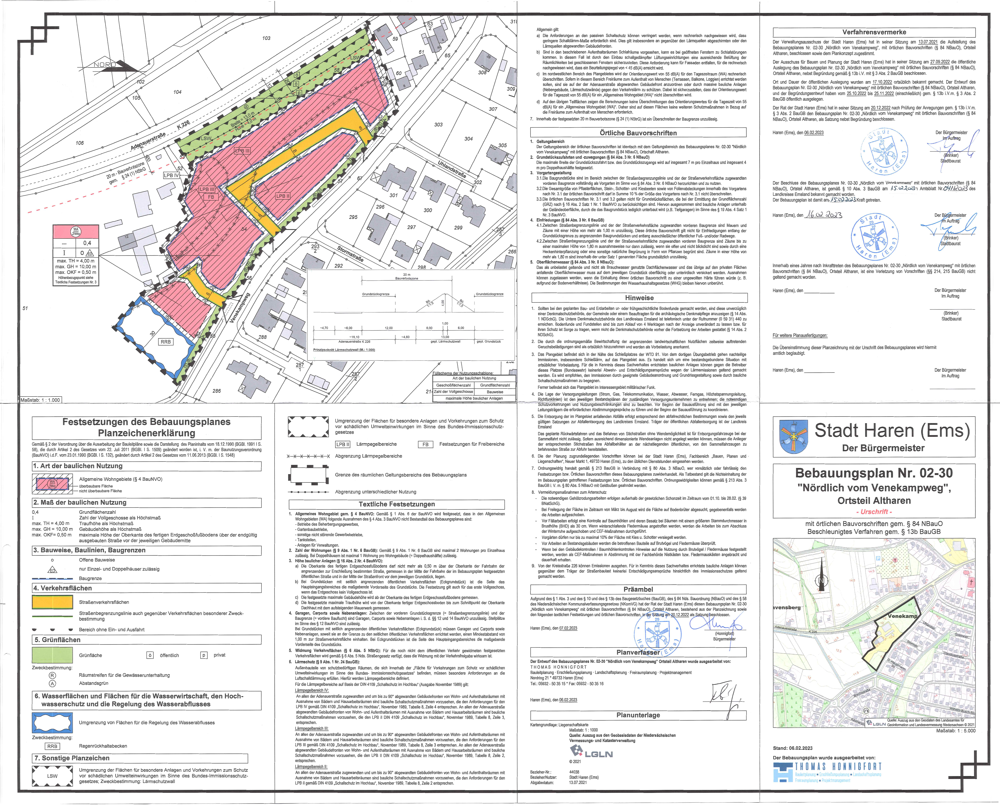

In [3]:
image

## Preprocess

In [4]:
import cv2
import numpy as np

def get_grayscale(input_img):
    return cv2.cvtColor(input_img, cv2.COLOR_BGR2GRAY)# noise removal
    
def remove_noise(input_img):
    return cv2.medianBlur(input_img,5)
 
#thresholding
def thresholding(input_img):
    return cv2.threshold(input_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    
#dilation
def dilate(input_img):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(input_img, kernel, iterations = 1)
    
#erosion
def erode(input_img):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(input_img, kernel, iterations = 1)
    
#opening - erosion followed by dilation    
def opening(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    
#canny edge detection
def canny(input_img):
    return cv2.Canny(input_img, 100, 200)#skew correction
    
def deskew(input_img):
    coords = np.column_stack(np.where(input_img > 0))
    angle = cv2.minAreaRect(coords)[-1]
    if angle < -45:
        angle = -(90 + angle)
    else:
        angle = -angle
    (h, w) = input_img.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(input_img, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return rotated
    
#template matching
def match_template(input_img, template):
    return cv2.matchTemplate(input_img, template, cv2.TM_CCOEFF_NORMED)

In [45]:
def preprocess(input_img):
    tmp_img = get_grayscale(input_img)
    tmp_img = thresholding(tmp_img)
    #tmp_img = opening(tmp_img)
    #tmp_img = canny(tmp_img)
    return tmp_img

In [46]:
def pil_to_cv2(pil_image):
    open_cv_image = np.array(pil_image) 
    # Convert RGB to BGR 
    open_cv_image = open_cv_image[:, :, ::-1].copy() 
    return open_cv_image

In [47]:
original_img = pil_to_cv2(image)
img = preprocess(original_img)

## OCR

In [48]:
import pytesseract
from pytesseract import Output
d = pytesseract.image_to_data(img, output_type=Output.DICT, lang="deu")
print(d.keys())

dict_keys(['level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf', 'text'])


In [49]:
n_boxes = len(d['text'])
for i in range(n_boxes):
    if int(d['conf'][i]) > 60:
        (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
        original_img = cv2.rectangle(original_img, (x, y), (x + w, y + h), (0, 255, 0), 2)
        #cv2.imshow('img', img)
#cv2.waitKey(0)

In [50]:
def cv2_to_rgb(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def plot_image(img, title="Image"):
    plt.figure(figsize=(56,28 ))
    plt.imshow(img)
    plt.title(title)
    plt.axis('off')
    plt.savefig("result.png")
    plt.show()


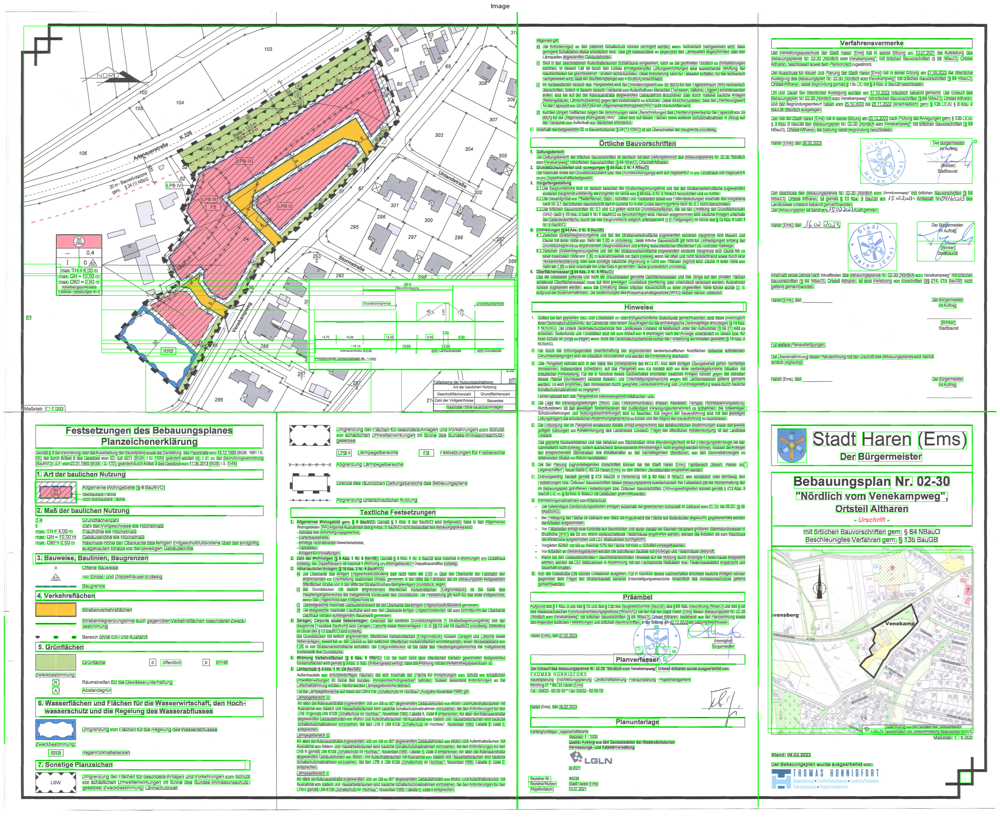

In [51]:
import matplotlib.pyplot as plt

img = cv2_to_rgb(original_img)
# display that image
plot_image(img)


In [31]:
def get_angle_and_language(input_img):
    osd = pytesseract.image_to_osd(input_img)
    angle = re.search('(?<=Rotate: )\d+', osd).group(0)
    script = re.search('(?<=Script: )\d+', osd).group(0)
    print("angle: ", angle)
    print("script: ", script)
    return angle, script

In [32]:
d.keys()


dict_keys(['level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf', 'text'])

In [52]:
d["text"]

['',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 '  ',
 '',
 ' ',
 '',
 '  ',
 '',
 '',
 '',
 'max.',
 'TH',
 '=',
 '4,00',
 'm',
 '',
 'max.',
 'GH',
 '=',
 '10,00',
 'm',
 '',
 'max.',
 'OKF',
 '=',
 '0,50',
 'm',
 '',
 '',
 '',
 'Höhenbezugspunkt',
 'siehe',
 '',
 'Textliche',
 'Festsetzungen',
 'Nr.',
 '3',
 '',
 '',
 '',
 '51',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 'j',
 '',
 '[JMaßstab:',
 '1:',
 '1.000',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 'Festsetzungen',
 'des',
 'Bebauungsplanes',
 '',
 'Planzeichenerklärung',
 '',
 '',
 '',
 'Gemäß',
 '$',
 '2',
 'der',
 'Verordnung',
 'über',
 'die',
 'Ausarbeitung',
 'der',
 'Bauleitpläne',
 'sowie',
 'die',
 'Darstellung',
 'des',
 'Planinhalts',
 'vom',
 '18.12.1990',
 '(BGBl.',
 '1991',
 '1S.',
 '',
 '58),',
 'die',
 'durch',
 'Artikel',
 '2',
 'des',
 'Gesetzes',
 'vom',
 '22.',
 'Juli',
 '2011',
 '(BGBl.',
 '|',
 'S.',
 '1509)',
 'geändert',
 'worden',
 'ist,